# Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from numpy.linalg import inv
import itertools
import pandas as pd
%matplotlib inline
%load_ext autoreload
%autoreload 2
import pickle
from utils import plot_embedings2d, plotly_embedings2d

# Read pairs

In [2]:
edges_df = pd.read_csv("data/mammal_connections.csv", index_col='id')
# edges_df = edges_df.drop_duplicates()

In [3]:
df = pd.read_csv("data/mammal.csv", index_col='id')
print(df.shape)
df[:3]

(6542, 2)


,A,B
id,,
0,big_cat.n.01,carnivore.n.01
1,musteline_mammal.n.01,carnivore.n.01
2,yak.n.02,ox.n.02


In [4]:
left2index = {w: i for i, w in enumerate(df.A.unique())}
right2index = {w: i for i, w in enumerate(df.B.unique())}

len(left2index), len(right2index), len(set(df.B.unique()))

(1181, 293, 293)

In [5]:
corpus = set(df.A.unique()) | set(df.B.unique())

word2index = {w: i for i, w in enumerate(corpus)}
index2word = {i: w for i, w in enumerate(corpus)}

len(word2index)

1182

In [6]:

# pickle.dump(index2word, open("models/index2word.pkl", 'wb'))

In [6]:
index2word = pickle.load(open("models/index2word.pkl", 'rb'))
word2index = {v: k for k, v in index2word.items()}
len(word2index)

1182

In [7]:
num_words = len(corpus)
num_words

1182

In [8]:
df.A = df.A.map(word2index)
df.B = df.B.map(word2index)
df[:3]

,A,B
id,,
0,180,1124
1,797,1124
2,391,714


In [10]:
x_train, y_train = df.values[:, 0], df.values[:, 1]
x_train = np.expand_dims(x_train, -1)
y_train = np.expand_dims(y_train, -1)
x_train.shape, y_train.shape

((6542, 1), (6542, 1))

## Data generator for sampling

In [11]:
def data_generator(x_data, y_data, num_samples=10, batch_size = 32):
    indices = np.array(list(range(x_data.shape[0])))
    while True:
        random_batch = np.random.choice(indices, batch_size, replace=False)
        x_batch = x_data[random_batch]
        y_batch = y_data[random_batch]
        
        x_samples = []
        for b in range(batch_size):
            random_batch = np.random.choice(indices, num_samples, replace=False)            
            x_sample = x_data[random_batch][:, 0]   
            if (np.where(x_batch[b, 0] == x_sample)[0].shape[0] == 0):
                x_sample[0] = x_batch[b, 0]
                
            x_samples.append(x_sample)        
        x_samples = np.array(x_samples)        
        yield [x_batch, y_batch, x_samples], y_batch
        
        
# define training generator
num_samples = 20
train_gen = data_generator(x_train, y_train, num_samples=num_samples)
[x_batch, y_batch, x_samples], y_labels = next(train_gen)
x_batch.shape, x_samples.shape, y_batch.shape

((32, 1), (32, 20), (32, 1))

# Keras model

## Imports

In [12]:
import keras
from keras.layers import *
from keras.models import *
from keras.losses import *
from keras.optimizers import *
import keras.backend as K
import tensorflow as tf

def custom_loss(y_true, y_pred):
    return K.mean(y_pred)

def plot_embedings(word_embd_layer, mode='plt', center=True):
    
    w_embd = word_embd_layer.get_weights()[0]
    words = list(map(lambda x: index2word[x], range(num_words)))
    embeddings_df = pd.DataFrame( w_embd, columns=['x1', 'x2'], index=words)
    
    if mode == 'plt':
        plot_embedings2d(embeddings_df, edges_df, center)  
    elif mode == 'plotly':
        plotly_embedings2d(embeddings_df, edges_df, center)

Using TensorFlow backend.


## Check inner products

In [13]:
def get_inner_model(latent_dim = 2):
    
    left_input = Input(shape=(1,))
    word_embd = Embedding(num_words, output_dim=latent_dim, name='embeddings')
    u_word = word_embd(left_input)

    def u_w_distance(u):        
        w = word_embd.weights[0]    
        return K.dot(u, K.transpose(w))

    x = Lambda(u_w_distance)(u_word)
    x = Reshape(target_shape=[-1])(x)
    x = Activation('softmax')(x)

    model = Model(inputs=left_input, outputs=x)
    
    return model

model = get_inner_model(latent_dim = 2)

In [14]:
model.compile(optimizer=Adam(0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=20)

model.compile(optimizer=Adam(0.005), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=30)

model.compile(optimizer=Adam(0.002), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=10)

model.compile(optimizer=Adam(0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=10)

Epoch 1/20
6542/6542 [==============================] - 1s - loss: 7.0749 - acc: 0.0017       
Epoch 2/20
6542/6542 [==============================] - 1s - loss: 7.0725 - acc: 0.0335     
Epoch 3/20
6542/6542 [==============================] - 1s - loss: 7.0580 - acc: 0.0706     
Epoch 4/20
6542/6542 [==============================] - 1s - loss: 7.0199 - acc: 0.0827     
Epoch 5/20
6542/6542 [==============================] - 1s - loss: 6.9575 - acc: 0.0914     
Epoch 6/20
6542/6542 [==============================] - 1s - loss: 6.8736 - acc: 0.0969     
Epoch 7/20
6542/6542 [==============================] - 1s - loss: 6.7714 - acc: 0.1042     
Epoch 8/20
6542/6542 [==============================] - 1s - loss: 6.6530 - acc: 0.1102     
Epoch 9/20
6542/6542 [==============================] - 1s - loss: 6.5212 - acc: 0.1128     
Epoch 10/20
6542/6542 [==============================] - 1s - loss: 6.3786 - acc: 0.1131     
Epoch 11/20
6542/6542 [==============================] - 1s - loss:

In [15]:
model.save_weights("models/inner_product.h5")

In [16]:
model = get_inner_model(latent_dim = 2)
model.load_weights("models/inner_product.h5")

28  targets found


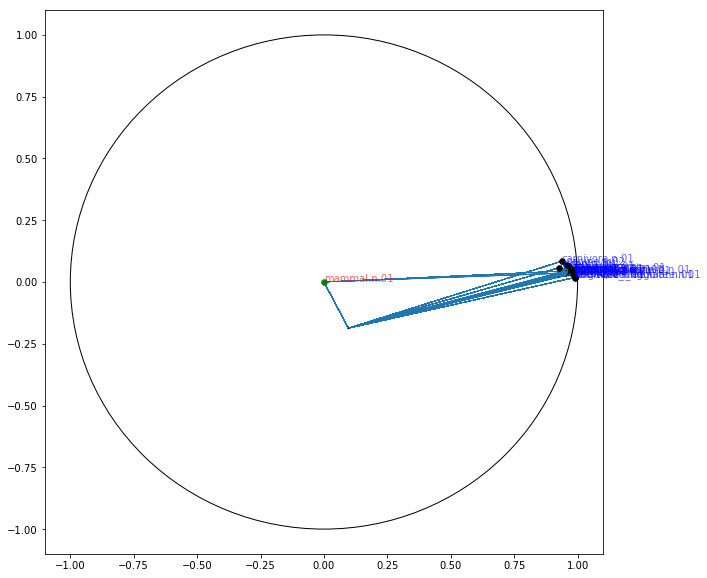

In [17]:
plot_embedings(model.get_layer('embeddings'))

In [18]:
plot_embedings(model.get_layer('embeddings'), mode='plotly', center=False)

## Check euclides distance

In [19]:
def get_euclides_model(latent_dim = 2):
    left_input = Input(shape=(1,))
    word_embd = Embedding(num_words, output_dim=latent_dim, name='embeddings')
    u_word = word_embd(left_input)
    u_word = Reshape(target_shape=[-1])(u_word)

    def u_w_distance(u):        
        w = word_embd.weights[0]

        ww = K.expand_dims(K.sum(K.square(w), 1), -1)
        uu = K.expand_dims(K.sum(K.square(u), -1), -1)    
        dist_uw_2 = - 2 * K.dot(u, K.transpose(w)) + uu + K.transpose(ww)
        return - dist_uw_2 # with sqrt model was performing badly... 

    x = Lambda(u_w_distance)(u_word)
    x = Activation('softmax')(x)
    model = Model(inputs=left_input, outputs=x)
    return model

model = get_euclides_model(latent_dim = 2)

Epoch 1/20
6542/6542 [==============================] - 1s - loss: 7.0693 - acc: 0.0000e+00     
Epoch 2/20
6542/6542 [==============================] - 1s - loss: 7.0478 - acc: 0.0000e+00     
Epoch 3/20
6542/6542 [==============================] - 1s - loss: 7.0020 - acc: 0.0000e+00     
Epoch 4/20
6542/6542 [==============================] - 1s - loss: 6.9445 - acc: 0.0000e+00     
Epoch 5/20
6542/6542 [==============================] - 1s - loss: 6.8965 - acc: 0.0000e+00     
Epoch 6/20
6542/6542 [==============================] - 1s - loss: 6.8632 - acc: 0.0000e+00     
Epoch 7/20
6542/6542 [==============================] - 1s - loss: 6.8404 - acc: 0.0000e+00     
Epoch 8/20
6542/6542 [==============================] - 1s - loss: 6.8237 - acc: 0.0000e+00     
Epoch 9/20
6542/6542 [==============================] - 1s - loss: 6.8108 - acc: 0.0000e+00     
Epoch 10/20
6542/6542 [==============================] - 1s - loss: 6.8002 - acc: 0.0000e+00     
Epoch 11/20
6542/6542 [======

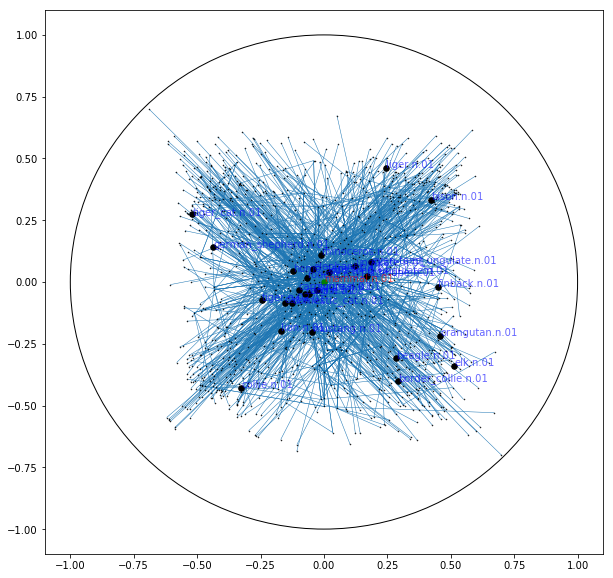

Epoch 1/30
6542/6542 [==============================] - 1s - loss: 6.7241 - acc: 0.0000e+00     
Epoch 2/30
6542/6542 [==============================] - 1s - loss: 6.7107 - acc: 0.0000e+00     
Epoch 3/30
6542/6542 [==============================] - 1s - loss: 6.7004 - acc: 0.0000e+00     
Epoch 4/30
6542/6542 [==============================] - 1s - loss: 6.6898 - acc: 0.0000e+00     
Epoch 5/30
6542/6542 [==============================] - 1s - loss: 6.6789 - acc: 0.0000e+00     
Epoch 6/30
6542/6542 [==============================] - 1s - loss: 6.6678 - acc: 0.0000e+00     
Epoch 7/30
6542/6542 [==============================] - 1s - loss: 6.6563 - acc: 0.0000e+00     
Epoch 8/30
6542/6542 [==============================] - 1s - loss: 6.6445 - acc: 0.0000e+00     
Epoch 9/30
6542/6542 [==============================] - 1s - loss: 6.6327 - acc: 0.0000e+00     
Epoch 10/30
6542/6542 [==============================] - 1s - loss: 6.6205 - acc: 0.0000e+00     
Epoch 11/30
6542/6542 [======

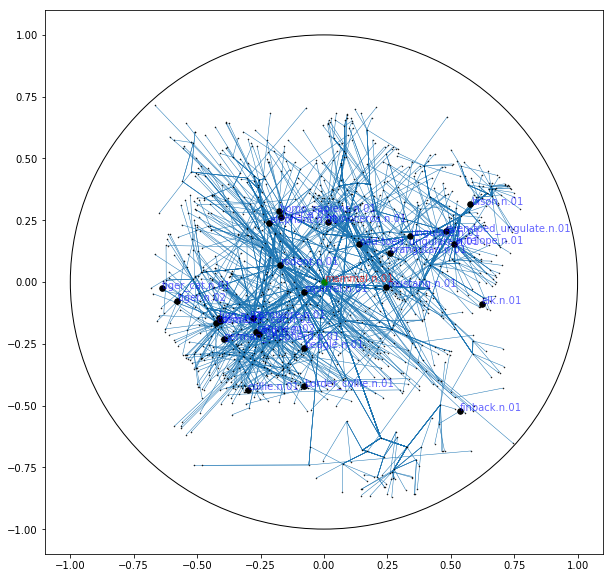

Epoch 1/15
6542/6542 [==============================] - 1s - loss: 6.4221 - acc: 0.0000e+00     
Epoch 2/15
6542/6542 [==============================] - 1s - loss: 6.3655 - acc: 0.0000e+00     
Epoch 3/15
6542/6542 [==============================] - 1s - loss: 6.3365 - acc: 0.0000e+00     
Epoch 4/15
6542/6542 [==============================] - 1s - loss: 6.3114 - acc: 0.0000e+00     
Epoch 5/15
6542/6542 [==============================] - 1s - loss: 6.2909 - acc: 0.0000e+00     
Epoch 6/15
6542/6542 [==============================] - 1s - loss: 6.2710 - acc: 0.0000e+00     
Epoch 7/15
6542/6542 [==============================] - 1s - loss: 6.2538 - acc: 0.0000e+00     
Epoch 8/15
6542/6542 [==============================] - 1s - loss: 6.2365 - acc: 0.0000e+00     
Epoch 9/15
6542/6542 [==============================] - 1s - loss: 6.2208 - acc: 0.0000e+00     
Epoch 10/15
6542/6542 [==============================] - 1s - loss: 6.2063 - acc: 0.0000e+00     
Epoch 11/15
6542/6542 [======

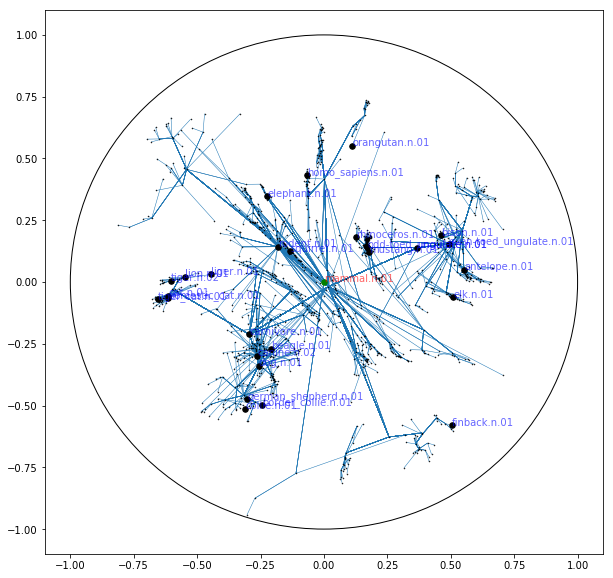

Epoch 1/15
6542/6542 [==============================] - 1s - loss: 6.1311 - acc: 0.0000e+00     
Epoch 2/15
6542/6542 [==============================] - 1s - loss: 6.1268 - acc: 0.0000e+00     
Epoch 3/15
6542/6542 [==============================] - 1s - loss: 6.1252 - acc: 0.0000e+00     
Epoch 4/15
6542/6542 [==============================] - 1s - loss: 6.1239 - acc: 0.0000e+00     
Epoch 5/15
6542/6542 [==============================] - 1s - loss: 6.1225 - acc: 0.0000e+00     
Epoch 6/15
6542/6542 [==============================] - 1s - loss: 6.1213 - acc: 0.0000e+00     
Epoch 7/15
6542/6542 [==============================] - 1s - loss: 6.1201 - acc: 0.0000e+00     
Epoch 8/15
6542/6542 [==============================] - 1s - loss: 6.1189 - acc: 0.0000e+00     
Epoch 9/15
6542/6542 [==============================] - 1s - loss: 6.1178 - acc: 0.0000e+00     
Epoch 10/15
6542/6542 [==============================] - 1s - loss: 6.1167 - acc: 0.0000e+00     
Epoch 11/15
6542/6542 [======

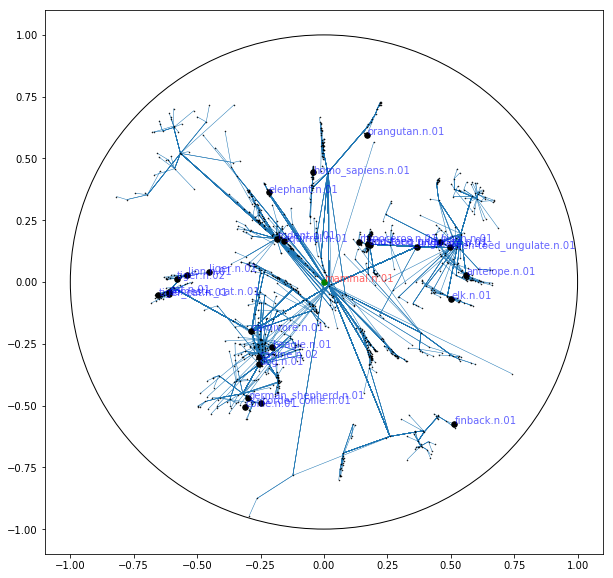

In [20]:
model.compile(optimizer=Adam(0.0005), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=20)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=30)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.005), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=15)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, batch_size=32, epochs=15)
plot_embedings(model.get_layer('embeddings'))

In [21]:
model.save_weights("models/euclides.h5")

In [22]:
model = get_euclides_model(latent_dim=2)
model.load_weights("models/euclides.h5")

In [23]:
plot_embedings(model.get_layer('embeddings'), mode='plotly')

## Check euclides distance with sampling

### Define model with sampling

In [24]:
def get_euclides_with_sampling(latent_dim = 2):

    left_input = Input(shape=(1,))
    right_input = Input(shape=(1,))
    left_samples = Input(shape=(num_samples,))

    word_embd = Embedding(num_words, output_dim=latent_dim, name='embeddings')

    u_word = word_embd(left_input)
    v_word = word_embd(right_input)
    u_samples = word_embd(left_samples)

    def u_w_distance(x):
        u, u_s = x
        ww = K.expand_dims(K.sum(K.square(u_s), -1), -1)
        uu = K.expand_dims(K.sum(K.square(u), -1), -1)     
        dot = K.sum(u * u_s, -1, keepdims=True)    
        dist_uw_2 = uu + ww - 2 * dot
        return dist_uw_2 


    us_distance = Reshape([-1])(Lambda(u_w_distance)([u_word, u_samples]))
    uv_distance = Reshape([-1])(Lambda(u_w_distance)([u_word, v_word]))


    def sampled_loss(x):
        uv_distance, us_distance = x
        uv_distance = K.exp( - uv_distance)
        us_distance = K.sum( K.exp( - us_distance), -1, keepdims=True)
        loss = - K.log(uv_distance/(us_distance + K.epsilon()) + K.epsilon())
        return loss

    x = Lambda(sampled_loss)([uv_distance, us_distance])

    model = Model([left_input, right_input, left_samples], x)
    word_embd.set_weights([word_embd.get_weights()[0]*0.1])
    return model

model = get_euclides_with_sampling(latent_dim = 2)

### Train model with sampling (naive gradients)

Epoch 1/20
500/500 [==============================] - 4s - loss: 2.9604 - acc: 0.0000e+00     
Epoch 2/20
500/500 [==============================] - 3s - loss: 2.8404 - acc: 0.0000e+00     
Epoch 3/20
500/500 [==============================] - 3s - loss: 2.7690 - acc: 0.0000e+00     
Epoch 4/20
500/500 [==============================] - 3s - loss: 2.7292 - acc: 0.0000e+00     
Epoch 5/20
500/500 [==============================] - 3s - loss: 2.7011 - acc: 0.0000e+00     
Epoch 6/20
500/500 [==============================] - 3s - loss: 2.6735 - acc: 0.0000e+00     
Epoch 7/20
500/500 [==============================] - 3s - loss: 2.6507 - acc: 0.0000e+00     
Epoch 8/20
500/500 [==============================] - 3s - loss: 2.6263 - acc: 0.0000e+00     
Epoch 9/20
500/500 [==============================] - 3s - loss: 2.5999 - acc: 0.0000e+00     
Epoch 10/20
500/500 [==============================] - 3s - loss: 2.5705 - acc: 0.0000e+00     
Epoch 11/20
500/500 [============================

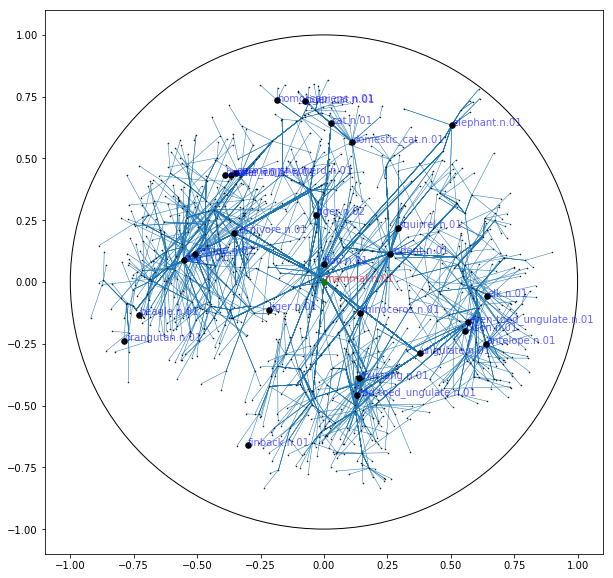

Epoch 1/30
500/500 [==============================] - 4s - loss: 2.3190 - acc: 3.7500e-04     
Epoch 2/30
500/500 [==============================] - 3s - loss: 2.2630 - acc: 6.8750e-04     
Epoch 3/30
500/500 [==============================] - 3s - loss: 2.2524 - acc: 5.6250e-04     
Epoch 4/30
500/500 [==============================] - 3s - loss: 2.2422 - acc: 4.3750e-04     
Epoch 5/30
500/500 [==============================] - 3s - loss: 2.2223 - acc: 8.7500e-04     
Epoch 6/30
500/500 [==============================] - 3s - loss: 2.2187 - acc: 6.8750e-04     
Epoch 7/30
500/500 [==============================] - 3s - loss: 2.2215 - acc: 5.0000e-04     
Epoch 8/30
500/500 [==============================] - 3s - loss: 2.2259 - acc: 5.0000e-04     
Epoch 9/30
500/500 [==============================] - 3s - loss: 2.2289 - acc: 5.6250e-04     
Epoch 10/30
500/500 [==============================] - 3s - loss: 2.2163 - acc: 0.0013     
Epoch 11/30
500/500 [==============================] 

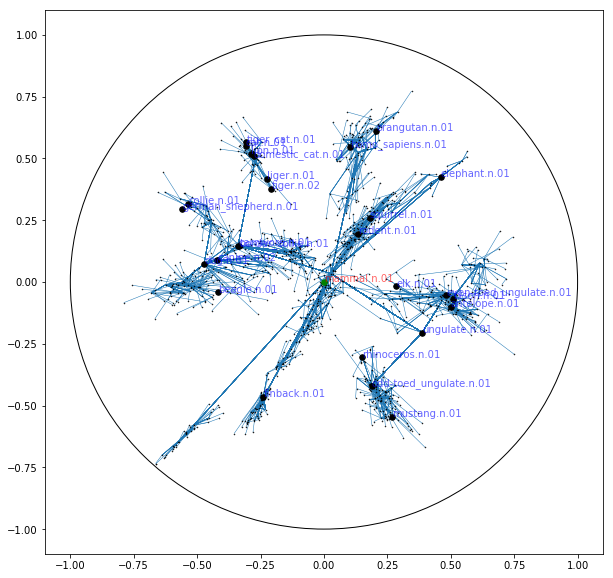

Epoch 1/10
500/500 [==============================] - 4s - loss: 2.1823 - acc: 8.1250e-04     
Epoch 2/10
500/500 [==============================] - 3s - loss: 2.1693 - acc: 0.0018     
Epoch 3/10
500/500 [==============================] - 3s - loss: 2.1711 - acc: 1.0000e-03    
Epoch 4/10
500/500 [==============================] - 3s - loss: 2.1672 - acc: 4.3750e-04     
Epoch 5/10
500/500 [==============================] - 3s - loss: 2.1778 - acc: 8.1250e-04     
Epoch 6/10
500/500 [==============================] - 3s - loss: 2.1685 - acc: 9.3750e-04     
Epoch 7/10
500/500 [==============================] - 3s - loss: 2.1715 - acc: 0.0012     
Epoch 8/10
500/500 [==============================] - 3s - loss: 2.1716 - acc: 6.8750e-04     
Epoch 9/10
500/500 [==============================] - 3s - loss: 2.1553 - acc: 4.3750e-04     
Epoch 10/10
500/500 [==============================] - 3s - loss: 2.1555 - acc: 5.6250e-04     
28  targets found


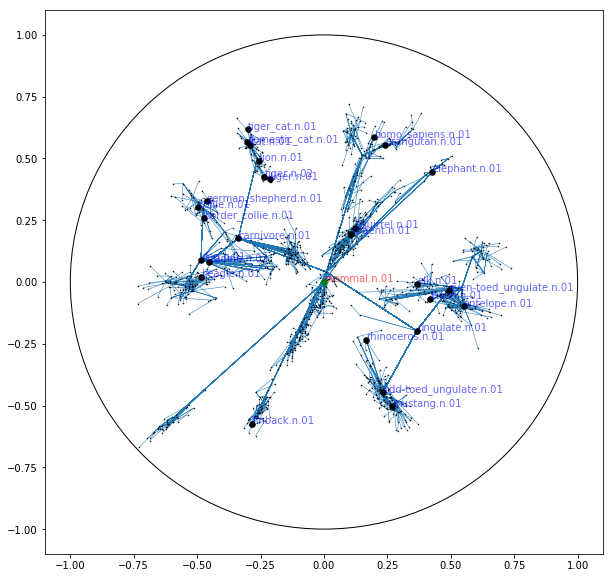

Epoch 1/10
500/500 [==============================] - 4s - loss: 2.1785 - acc: 6.2500e-04     
Epoch 2/10
500/500 [==============================] - 3s - loss: 2.1686 - acc: 0.0013     
Epoch 3/10
500/500 [==============================] - 3s - loss: 2.1787 - acc: 0.0014     
Epoch 4/10
500/500 [==============================] - 3s - loss: 2.1603 - acc: 0.0011     
Epoch 5/10
500/500 [==============================] - 3s - loss: 2.1504 - acc: 6.8750e-04     
Epoch 6/10
500/500 [==============================] - 3s - loss: 2.1554 - acc: 6.8750e-04     
Epoch 7/10
500/500 [==============================] - 3s - loss: 2.1584 - acc: 8.7500e-04     
Epoch 8/10
500/500 [==============================] - 3s - loss: 2.1569 - acc: 7.5000e-04     
Epoch 9/10
500/500 [==============================] - 3s - loss: 2.1696 - acc: 9.3750e-04     
Epoch 10/10
500/500 [==============================] - 3s - loss: 2.1522 - acc: 0.0012     
28  targets found


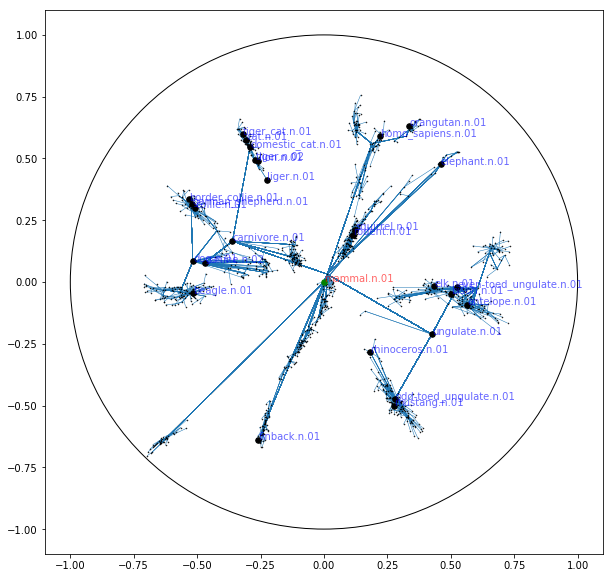

In [25]:
model.compile(optimizer=Adam(0.001), loss=custom_loss, metrics=['accuracy'])
model.fit_generator(train_gen, steps_per_epoch=500, epochs=20)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.01), loss=custom_loss, metrics=['accuracy'])
model.fit_generator(train_gen, steps_per_epoch=500, epochs=30)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.005), loss=custom_loss, metrics=['accuracy'])
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.001), loss=custom_loss, metrics=['accuracy'])
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)
plot_embedings(model.get_layer('embeddings'))

In [26]:
model.save_weights("models/euclides_sampled.h5")

In [27]:
model = get_euclides_with_sampling(latent_dim = 2)
model.load_weights("models/euclides_sampled.h5")

In [28]:
plot_embedings(model.get_layer('embeddings'), mode='plotly')

## Check Poincare (naive version without metric)

In [29]:
def get_poincare_model(latent_dim = 2):

    left_input = Input(shape=(1,))
    right_input = Input(shape=(1,))
    left_samples = Input(shape=(num_samples,))

    word_embd = Embedding(num_words, output_dim=latent_dim, name='embeddings')

    u_word = word_embd(left_input)
    v_word = word_embd(right_input)
    u_samples = word_embd(left_samples)

    def u_w_distance(x):
        u, v_s = x
        ww = K.expand_dims(K.sum(K.square(v_s), -1), -1)
        uu = K.expand_dims(K.sum(K.square(u), -1), -1) 

        dot = K.sum(u * v_s, -1, keepdims=True)    
        dist_uw_2 = uu + ww - 2 * dot
        return dist_uw_2


    uv_distance = Reshape([-1])(Lambda(u_w_distance)([u_word, v_word]))
    us_distance = Reshape([-1])(Lambda(u_w_distance)([u_word, u_samples]))


    def arcosh(x):    
        return K.log(x + K.sqrt( K.square(x) - 1 ))


    def to_poincare_disk(x):
        u, v, uv_dist = x     

        uu = K.sum(K.square(u), -1)
        vv = K.sum(K.square(v), -1)

        alpha = K.clip((1 - uu), K.epsilon(), 1 - K.epsilon())
        beta = K.clip((1 - vv), K.epsilon(), 1 - K.epsilon())

        gamma = 1 + 2 * uv_dist / (alpha * beta)
        gamma = K.maximum(gamma, 1.0 + K.epsilon())    
        return arcosh(gamma)

    uv_distance = Lambda(to_poincare_disk)([u_word, v_word, uv_distance])
    us_distance = Lambda(to_poincare_disk)([u_word, u_samples, us_distance])


    def sampled_loss(x):
        uv_distance, us_distance = x
        uv_distance = K.exp( - uv_distance)
        us_distance = K.sum( K.exp( - us_distance), -1, keepdims=True)
        loss = - K.log(uv_distance/(us_distance + K.epsilon()) + K.epsilon())
        return loss

    x = Lambda(sampled_loss)([uv_distance, us_distance])

    def custom_loss(y_true, y_pred):
        return K.mean(y_pred)

    model = Model([left_input, right_input, left_samples], x)
    word_embd.set_weights([word_embd.get_weights()[0]*0.1])
    return model
    
model = get_poincare_model(latent_dim = 2)

Epoch 1/20
500/500 [==============================] - 4s - loss: 2.9649     
Epoch 2/20
500/500 [==============================] - 3s - loss: 2.9157     
Epoch 3/20
500/500 [==============================] - 3s - loss: 2.8715     
Epoch 4/20
500/500 [==============================] - 3s - loss: 2.8325     
Epoch 5/20
500/500 [==============================] - 3s - loss: 2.7928     
Epoch 6/20
500/500 [==============================] - 3s - loss: 2.7631     
Epoch 7/20
500/500 [==============================] - 3s - loss: 2.7330     
Epoch 8/20
500/500 [==============================] - 3s - loss: 2.7084     
Epoch 9/20
500/500 [==============================] - 3s - loss: 2.6748     
Epoch 10/20
500/500 [==============================] - 3s - loss: 2.6520     
Epoch 11/20
500/500 [==============================] - 3s - loss: 2.6347     
Epoch 12/20
500/500 [==============================] - 3s - loss: 2.6102     
Epoch 13/20
500/500 [==============================] - 3s - loss: 2.5899 

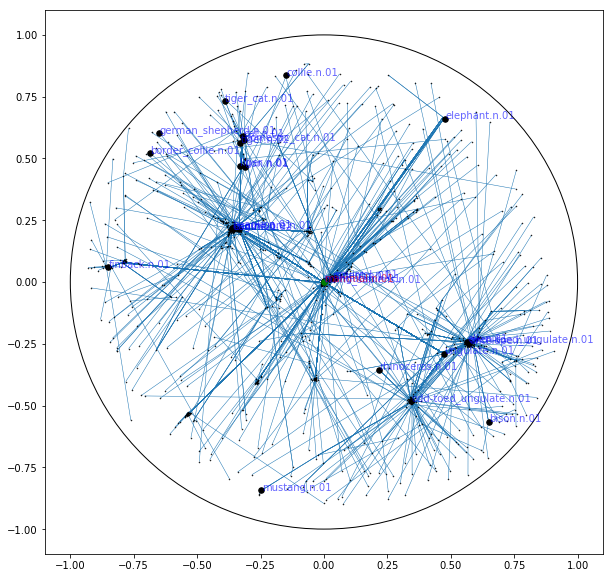

Epoch 1/30
500/500 [==============================] - 4s - loss: 2.4359     
Epoch 2/30
500/500 [==============================] - 3s - loss: 2.3775     
Epoch 3/30
500/500 [==============================] - 3s - loss: 2.3568     
Epoch 4/30
500/500 [==============================] - 3s - loss: 2.3244     
Epoch 5/30
500/500 [==============================] - 3s - loss: 2.2856     
Epoch 6/30
500/500 [==============================] - 3s - loss: 2.2669     
Epoch 7/30
500/500 [==============================] - 3s - loss: 2.2408     
Epoch 8/30
500/500 [==============================] - 3s - loss: 2.2113     
Epoch 9/30
500/500 [==============================] - 3s - loss: 2.1942     
Epoch 10/30
500/500 [==============================] - 3s - loss: 2.1975     
Epoch 11/30
500/500 [==============================] - 3s - loss: 2.1701     
Epoch 12/30
500/500 [==============================] - 3s - loss: 2.1502     
Epoch 13/30
500/500 [==============================] - 3s - loss: 2.1488 

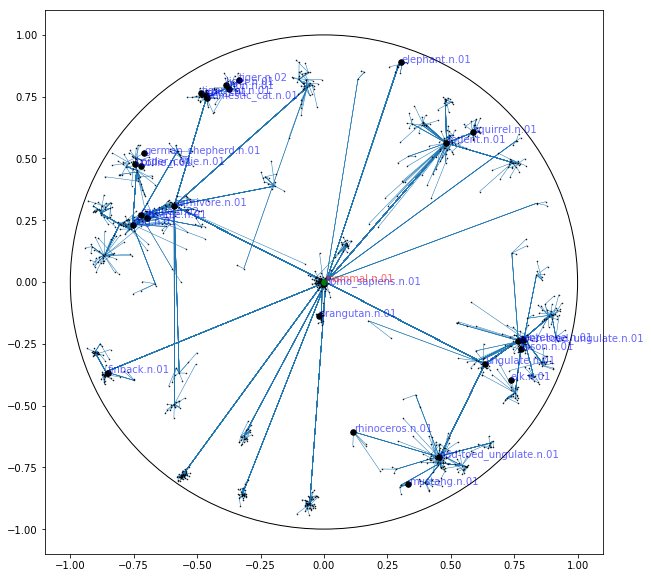

Epoch 1/10
500/500 [==============================] - 4s - loss: 2.0771     
Epoch 2/10
500/500 [==============================] - 3s - loss: 2.0565     
Epoch 3/10
500/500 [==============================] - 3s - loss: 2.0572     
Epoch 4/10
500/500 [==============================] - 3s - loss: 2.0542     
Epoch 5/10
500/500 [==============================] - 3s - loss: 2.0531     
Epoch 6/10
500/500 [==============================] - ETA: 0s - loss: 2.063 - 3s - loss: 2.0644     
Epoch 7/10
500/500 [==============================] - 3s - loss: 2.0684     
Epoch 8/10
500/500 [==============================] - 4s - loss: 2.0507     
Epoch 9/10
500/500 [==============================] - 3s - loss: 2.0632     
Epoch 10/10
500/500 [==============================] - 3s - loss: 2.0508     
28  targets found


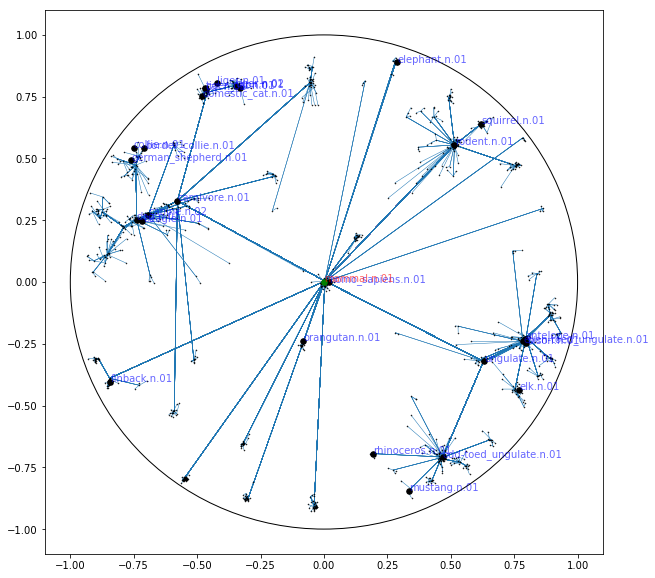

Epoch 1/10
500/500 [==============================] - 4s - loss: 2.0582     
Epoch 2/10
500/500 [==============================] - 3s - loss: 2.0552     
Epoch 3/10
500/500 [==============================] - 3s - loss: 2.0402     
Epoch 4/10
500/500 [==============================] - 3s - loss: 2.0443     
Epoch 5/10
500/500 [==============================] - 3s - loss: 2.0448     
Epoch 6/10
500/500 [==============================] - 3s - loss: 2.0416     
Epoch 7/10
500/500 [==============================] - 3s - loss: 2.0516     
Epoch 8/10
500/500 [==============================] - 3s - loss: 2.0550     
Epoch 9/10
500/500 [==============================] - 3s - loss: 2.0442     
Epoch 10/10
500/500 [==============================] - 4s - loss: 2.0554     
28  targets found


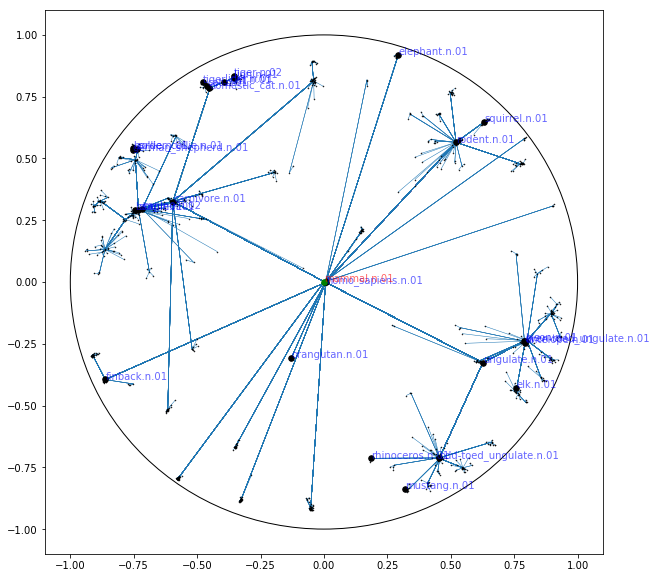

In [30]:
model.compile(optimizer=Adam(0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=20)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.002), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=30)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.001), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=Adam(0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)
plot_embedings(model.get_layer('embeddings'))

In [31]:
model.save_weights("models/poincare_naive_adam.h5")

In [32]:
model = get_poincare_model(latent_dim = 2)
model.load_weights("models/poincare_naive_adam.h5")

In [33]:
plot_embedings(model.get_layer('embeddings'), mode='plotly')

## Check Poincare with proper gradients

In [34]:
model = get_poincare_model(latent_dim = 2)

### SGD version

In [35]:
from optimizers import SGDPoincare

Epoch 1/25
500/500 [==============================] - 4s - loss: 2.9948     
Epoch 2/25
500/500 [==============================] - 3s - loss: 2.9942     
Epoch 3/25
500/500 [==============================] - 3s - loss: 2.9940     
Epoch 4/25
500/500 [==============================] - 3s - loss: 2.9939     
Epoch 5/25
500/500 [==============================] - 3s - loss: 2.9937     
Epoch 6/25
500/500 [==============================] - 3s - loss: 2.9937     
Epoch 7/25
500/500 [==============================] - 3s - loss: 2.9936     
Epoch 8/25
500/500 [==============================] - 3s - loss: 2.9935     
Epoch 9/25
500/500 [==============================] - 3s - loss: 2.9934     
Epoch 10/25
500/500 [==============================] - 4s - loss: 2.9934     
Epoch 11/25
500/500 [==============================] - 3s - loss: 2.9933     
Epoch 12/25
500/500 [==============================] - 3s - loss: 2.9933     - 
Epoch 13/25
500/500 [==============================] - 3s - loss: 2.993

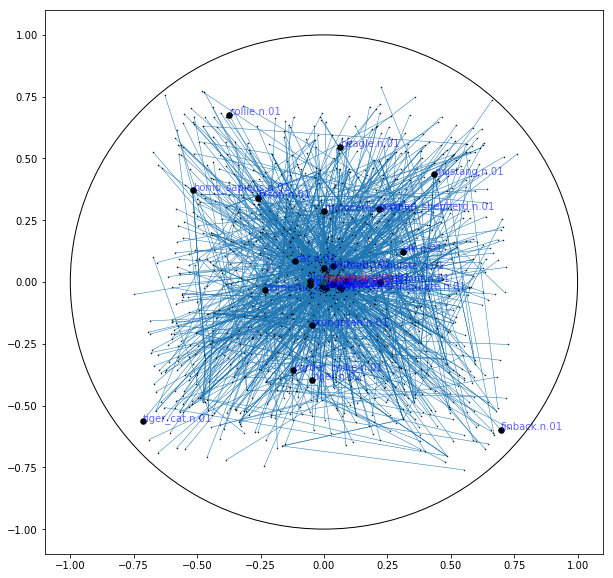

Epoch 1/20
500/500 [==============================] - 4s - loss: 2.9925     
Epoch 2/20
500/500 [==============================] - 3s - loss: 2.9924     
Epoch 3/20
500/500 [==============================] - 3s - loss: 2.9923     
Epoch 4/20
500/500 [==============================] - 3s - loss: 2.9922     
Epoch 5/20
500/500 [==============================] - 3s - loss: 2.9921     
Epoch 6/20
500/500 [==============================] - 3s - loss: 2.9920     
Epoch 7/20
500/500 [==============================] - 4s - loss: 2.9919     
Epoch 8/20
500/500 [==============================] - 4s - loss: 2.9919     
Epoch 9/20
500/500 [==============================] - 3s - loss: 2.9917     
Epoch 10/20
500/500 [==============================] - 4s - loss: 2.9916     
Epoch 11/20
500/500 [==============================] - 3s - loss: 2.9915     
Epoch 12/20
500/500 [==============================] - 4s - loss: 2.9914     
Epoch 13/20
500/500 [==============================] - 3s - loss: 2.9914 

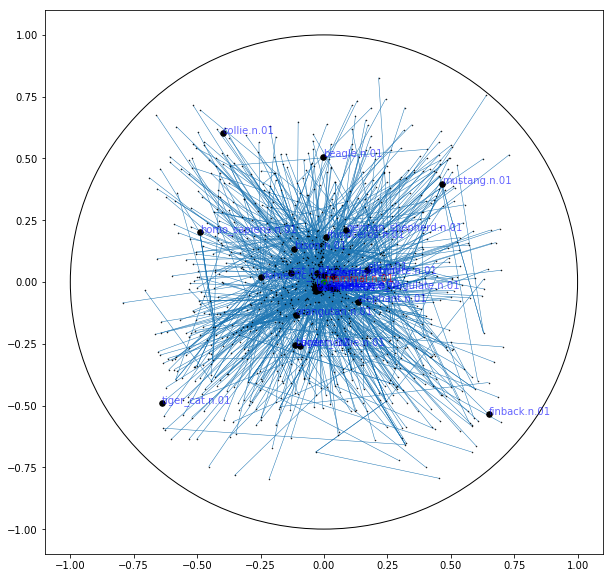

Epoch 1/20
500/500 [==============================] - 4s - loss: 2.9906     
Epoch 2/20
500/500 [==============================] - 4s - loss: 2.9904     
Epoch 3/20
500/500 [==============================] - 4s - loss: 2.9903     
Epoch 4/20
500/500 [==============================] - 3s - loss: 2.9901     
Epoch 5/20
500/500 [==============================] - 3s - loss: 2.9899     
Epoch 6/20
500/500 [==============================] - 4s - loss: 2.9896     
Epoch 7/20
500/500 [==============================] - 4s - loss: 2.9896     
Epoch 8/20
500/500 [==============================] - 4s - loss: 2.9894     
Epoch 9/20
500/500 [==============================] - 3s - loss: 2.9891     
Epoch 10/20
500/500 [==============================] - 3s - loss: 2.9889     
Epoch 11/20
500/500 [==============================] - 4s - loss: 2.9887     
Epoch 12/20
500/500 [==============================] - 3s - loss: 2.9886     
Epoch 13/20
500/500 [==============================] - 3s - loss: 2.9884 

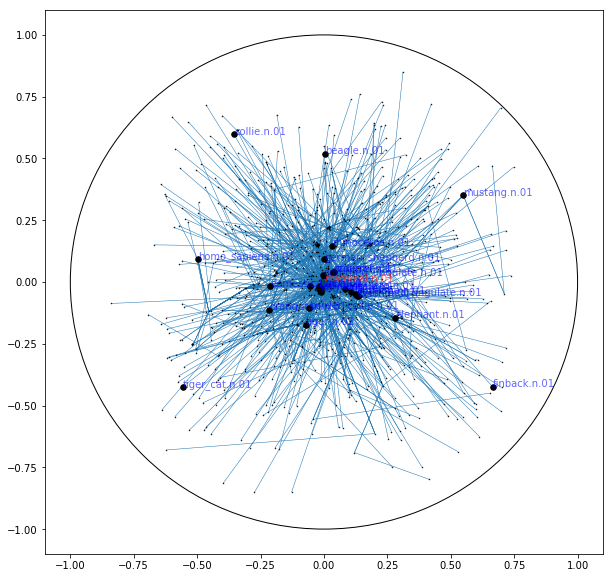

Epoch 1/10
500/500 [==============================] - 4s - loss: 2.9867     
Epoch 2/10
500/500 [==============================] - 3s - loss: 2.9867     
Epoch 3/10
500/500 [==============================] - 3s - loss: 2.9866     
Epoch 4/10
500/500 [==============================] - 4s - loss: 2.9866     
Epoch 5/10
500/500 [==============================] - 3s - loss: 2.9865     
Epoch 6/10
500/500 [==============================] - 3s - loss: 2.9864     
Epoch 7/10
500/500 [==============================] - 3s - loss: 2.9864     
Epoch 8/10
500/500 [==============================] - 3s - loss: 2.9864     
Epoch 9/10
500/500 [==============================] - 3s - loss: 2.9862     
Epoch 10/10
500/500 [==============================] - 3s - loss: 2.9862     
28  targets found


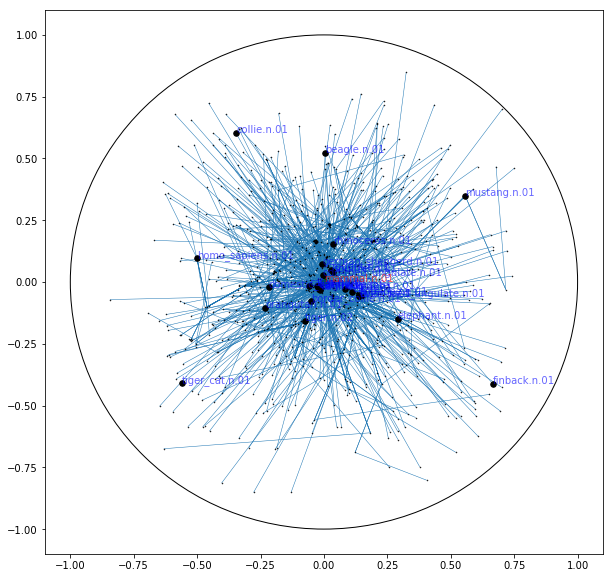

In [36]:
model.compile(optimizer=SGDPoincare(lr=0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=25)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=SGDPoincare(lr=0.001), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=20)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=SGDPoincare(lr=0.002), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=20)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=SGDPoincare(lr=0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)
plot_embedings(model.get_layer('embeddings'))

In [37]:
model.save_weights("models/poincare_sgd.h5")

In [38]:
model = get_poincare_model(latent_dim = 2)
model.load_weights("models/poincare_sgd.h5")

In [39]:
plot_embedings(model.get_layer('embeddings'), mode='plotly')

### Adam version

In [40]:
model = get_poincare_model(latent_dim = 2)

In [41]:
from optimizers import AdamPoincare

Epoch 1/20
500/500 [==============================] - 4s - loss: 2.9650     
Epoch 2/20
500/500 [==============================] - 3s - loss: 2.9164     
Epoch 3/20
500/500 [==============================] - 3s - loss: 2.8766     
Epoch 4/20
500/500 [==============================] - 3s - loss: 2.8379     
Epoch 5/20
500/500 [==============================] - 3s - loss: 2.8038     
Epoch 6/20
500/500 [==============================] - 3s - loss: 2.7713     
Epoch 7/20
500/500 [==============================] - 3s - loss: 2.7437     
Epoch 8/20
500/500 [==============================] - 3s - loss: 2.7130     
Epoch 9/20
500/500 [==============================] - 3s - loss: 2.6867     
Epoch 10/20
500/500 [==============================] - 3s - loss: 2.6698     
Epoch 11/20
500/500 [==============================] - 3s - loss: 2.6385     
Epoch 12/20
500/500 [==============================] - 3s - loss: 2.6183     
Epoch 13/20
500/500 [==============================] - 3s - loss: 2.5930 

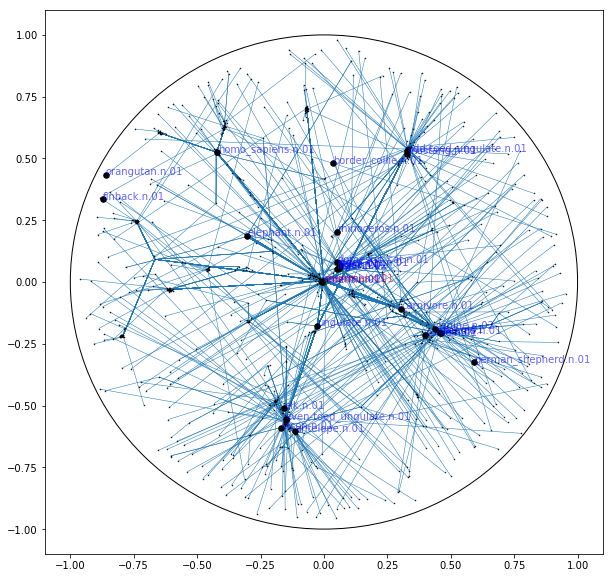

Epoch 1/30
500/500 [==============================] - 4s - loss: 2.4583     
Epoch 2/30
500/500 [==============================] - 3s - loss: 2.4326     
Epoch 3/30
500/500 [==============================] - 3s - loss: 2.4103     
Epoch 4/30
500/500 [==============================] - 3s - loss: 2.3768     
Epoch 5/30
500/500 [==============================] - 3s - loss: 2.3515     
Epoch 6/30
500/500 [==============================] - 3s - loss: 2.3313     
Epoch 7/30
500/500 [==============================] - 3s - loss: 2.3114     
Epoch 8/30
500/500 [==============================] - 3s - loss: 2.3114     
Epoch 9/30
500/500 [==============================] - 3s - loss: 2.2839     
Epoch 10/30
500/500 [==============================] - 3s - loss: 2.2721     
Epoch 11/30
500/500 [==============================] - 3s - loss: 2.2565     
Epoch 12/30
500/500 [==============================] - 3s - loss: 2.2517     
Epoch 13/30
500/500 [==============================] - 4s - loss: 2.2403 

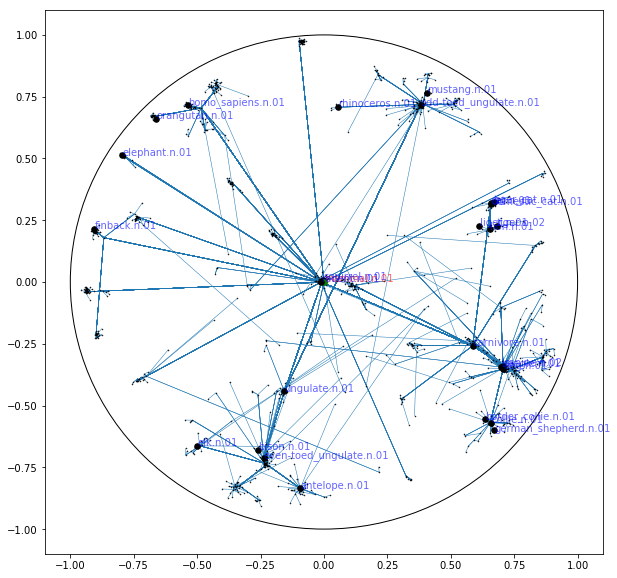

Epoch 1/10
500/500 [==============================] - 5s - loss: 2.1087     
Epoch 2/10
500/500 [==============================] - 3s - loss: 2.1309     
Epoch 3/10
500/500 [==============================] - 4s - loss: 2.1187     
Epoch 4/10
500/500 [==============================] - 3s - loss: 2.1180     
Epoch 5/10
500/500 [==============================] - 3s - loss: 2.0939     
Epoch 6/10
500/500 [==============================] - 3s - loss: 2.0968     
Epoch 7/10
500/500 [==============================] - 3s - loss: 2.0812     
Epoch 8/10
500/500 [==============================] - 3s - loss: 2.0876     
Epoch 9/10
500/500 [==============================] - ETA: 0s - loss: 2.099 - 3s - loss: 2.0981     
Epoch 10/10
500/500 [==============================] - 3s - loss: 2.0902     
28  targets found


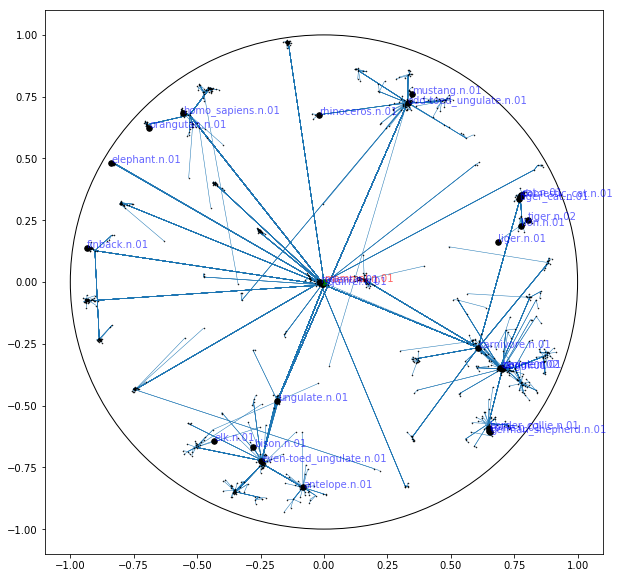

Epoch 1/10
500/500 [==============================] - 5s - loss: 2.0977     
Epoch 2/10
500/500 [==============================] - 3s - loss: 2.0813     
Epoch 3/10
500/500 [==============================] - 3s - loss: 2.0833     
Epoch 4/10
500/500 [==============================] - 4s - loss: 2.0781     
Epoch 5/10
500/500 [==============================] - 3s - loss: 2.0702     
Epoch 6/10
500/500 [==============================] - 4s - loss: 2.0927     
Epoch 7/10
500/500 [==============================] - 3s - loss: 2.0862     
Epoch 8/10
500/500 [==============================] - 3s - loss: 2.0812     
Epoch 9/10
500/500 [==============================] - 3s - loss: 2.0721     
Epoch 10/10
500/500 [==============================] - 3s - loss: 2.0773     
28  targets found


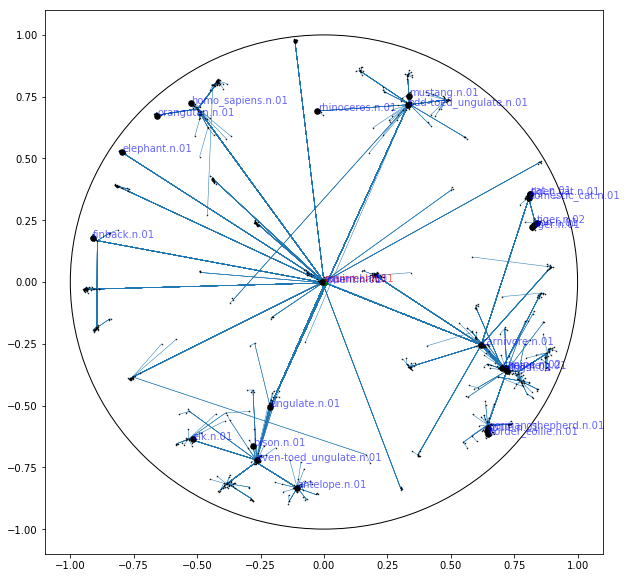

In [42]:
model.compile(optimizer=AdamPoincare(0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=20)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=AdamPoincare(0.001), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=30)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=AdamPoincare(0.0008), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)
plot_embedings(model.get_layer('embeddings'))

model.compile(optimizer=AdamPoincare(0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)
plot_embedings(model.get_layer('embeddings'))

In [43]:
model.save_weights("models/poincare_adam.h5")

In [44]:
model = get_poincare_model(latent_dim = 2)
model.load_weights("models/poincare_adam.h5")

In [45]:
plot_embedings(model.get_layer('embeddings'), mode='plotly', center=False)

## Check 3D embedings for Poincare with Adam

In [46]:
from utils import plotly_embedings3d

def plot_embedings3d(word_embd_layer):    
    w_embd = word_embd_layer.get_weights()[0]
    words = list(map(lambda x: index2word[x], range(num_words)))
    embeddings_df = pd.DataFrame( w_embd, columns=['x1', 'x2', 'x3'], index=words)        
    plotly_embedings3d(embeddings_df, edges_df)

In [47]:
from optimizers import AdamPoincare
model = get_poincare_model(latent_dim = 3)

In [48]:
model.compile(optimizer=AdamPoincare(0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=20)

model.compile(optimizer=AdamPoincare(0.001), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=30)

model.compile(optimizer=AdamPoincare(0.0008), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)

model.compile(optimizer=AdamPoincare(0.0005), loss=custom_loss)
model.fit_generator(train_gen, steps_per_epoch=500, epochs=10)

Epoch 1/20
500/500 [==============================] - 5s - loss: 2.9573     
Epoch 2/20
500/500 [==============================] - 3s - loss: 2.8974     
Epoch 3/20
500/500 [==============================] - 3s - loss: 2.8448     
Epoch 4/20
500/500 [==============================] - 4s - loss: 2.7923     
Epoch 5/20
500/500 [==============================] - 3s - loss: 2.7452     
Epoch 6/20
500/500 [==============================] - 4s - loss: 2.7042     
Epoch 7/20
500/500 [==============================] - 3s - loss: 2.6630     
Epoch 8/20
500/500 [==============================] - 3s - loss: 2.6259     
Epoch 9/20
500/500 [==============================] - 3s - loss: 2.5907     
Epoch 10/20
500/500 [==============================] - 3s - loss: 2.5591     
Epoch 11/20
500/500 [==============================] - 3s - loss: 2.5190     
Epoch 12/20
500/500 [==============================] - 3s - loss: 2.4963     
Epoch 13/20
500/500 [==============================] - 3s - loss: 2.4677 

In [49]:
model.save_weights("models/poincare_adam_3d.h5")

In [50]:
model = get_poincare_model(latent_dim = 3)
model.load_weights("models/poincare_adam_3d.h5")

In [51]:
plot_embedings3d(model.get_layer('embeddings'))